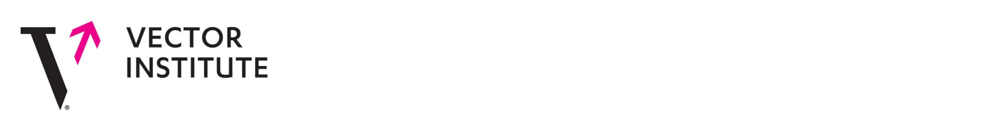

### **Welcome to the Machine Learning Course for Black and Indigenous Students!**
This program is offered by Vector Institute in its drive to build research and expand career pathways in the field of AI for under-represented populations.

*Instructor:* Bonaventure Molokwu | *Assignment Developer:* Manmeet Kaur Baxi | 

*Course Tutors:* Yinka Oladimeji and Manmeet Kaur Baxi | *Course Director:* Shingai Manjengwa (@Tjido) 

### ***Never stop learning!***

# Assignment II - Decision Trees

### Load python packages

In [1]:
import numpy as np    # matrices and high-level math functions
import pandas as pd   # data manipulation
import datetime       # working with dates 

# For data visualization
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

# For ML part
from sklearn.model_selection import train_test_split
from sklearn.experimental import enable_iterative_imputer
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import IterativeImputer
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor,StackingRegressor

# Set random seed so that the notebook's output is identical for every run
STATE = 2022
np.random.seed(2022)

### Import dataset

### About the dataset

**Context:**
You are provided with historical sales data for 45 stores located in different regions - each store contains a number of departments. The company also runs several promotional markdown events throughout the year. These markdowns precede prominent holidays, the four largest of which are the Super Bowl, Labor Day, Thanksgiving, and Christmas. The weeks including these holidays are weighted five times higher in the evaluation than non-holiday weeks.

**Data files:**
1. 'stores.csv': Anonymized information about the 45 stores, indicating the type and size of store
2. 'features.csv': Contains additional data related to the store, department, and regional activity for the given dates.
3. 'sales.csv': Historical sales data, which covers to 2010-02-05 to 2012-11-01.

*Credits:* https://www.kaggle.com/manjeetsingh/retaildataset

In [2]:
PATH = 'https://raw.githubusercontent.com/bhevencious/datasets/main/'

sales_df = pd.read_csv(PATH+'sales.csv')
stores_df = pd.read_csv(PATH+'stores.csv')
features_df = pd.read_csv(PATH+'features.csv')

# Convert object types to datetime
features_df['Date'] = pd.to_datetime(features_df['Date'])
sales_df['Date'] = pd.to_datetime(sales_df['Date'])

# Merge datasets
features_df = features_df.merge(stores_df, on='Store')
df = features_df.merge(sales_df, on=['Store','Date','IsHoliday'])

In [3]:
#features_df = pd.read_csv(features, header=0)

### Exploratory data analysis and data visualization

In [4]:
df.info()
df.describe().T

<class 'pandas.core.frame.DataFrame'>
Int64Index: 421570 entries, 0 to 421569
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   Store         421570 non-null  int64         
 1   Date          421570 non-null  datetime64[ns]
 2   Temperature   421570 non-null  float64       
 3   Fuel_Price    421570 non-null  float64       
 4   MarkDown1     150681 non-null  float64       
 5   MarkDown2     111248 non-null  float64       
 6   MarkDown3     137091 non-null  float64       
 7   MarkDown4     134967 non-null  float64       
 8   MarkDown5     151432 non-null  float64       
 9   CPI           421570 non-null  float64       
 10  Unemployment  421570 non-null  float64       
 11  IsHoliday     421570 non-null  bool          
 12  Type          421570 non-null  object        
 13  Size          421570 non-null  int64         
 14  Dept          421570 non-null  int64         
 15  Weekly_Sales  421

,count,mean,std,min,25%,50%,75%,max
Store,421570.0,22.200546,12.785297,1.000,11.000000,22.00000,33.000000,45.000000
Temperature,421570.0,60.090059,18.447931,-2.060,46.680000,62.09000,74.280000,100.140000
Fuel_Price,421570.0,3.361027,0.458515,2.472,2.933000,3.45200,3.738000,4.468000
MarkDown1,150681.0,7246.420196,8291.221345,0.270,2240.270000,5347.45000,9210.900000,88646.760000
MarkDown2,111248.0,3334.628621,9475.357325,-265.760,41.600000,192.00000,1926.940000,104519.540000
MarkDown3,137091.0,1439.421384,9623.078290,-29.100,5.080000,24.60000,103.990000,141630.610000
MarkDown4,134967.0,3383.168256,6292.384031,0.220,504.220000,1481.31000,3595.040000,67474.850000
MarkDown5,151432.0,4628.975079,5962.887455,135.160,1878.440000,3359.45000,5563.800000,108519.280000
CPI,421570.0,171.201947,39.159276,126.064,132.022667,182.31878,212.416993,227.232807
Unemployment,421570.0,7.960289,1.863296,3.879,6.891000,7.86600,8.572000,14.313000


### Check for duplicates

In [5]:
# Check for duplicates
print('Duplicates:',df.duplicated().sum())

Duplicates: 0


### Plot a trend of selected variables (Temperature, Fuel price, CPI, unemployment)

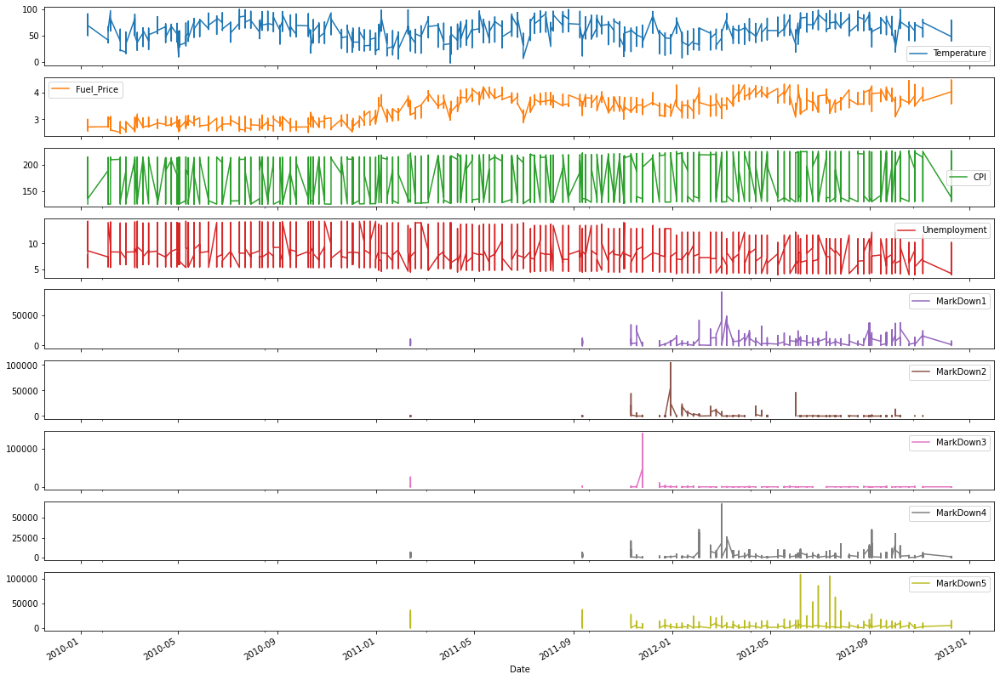

In [6]:
df[['Date', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment', 
    'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5']].plot(x='Date', subplots=True, figsize=(20,15))
plt.show()

### Plot distribution of variables

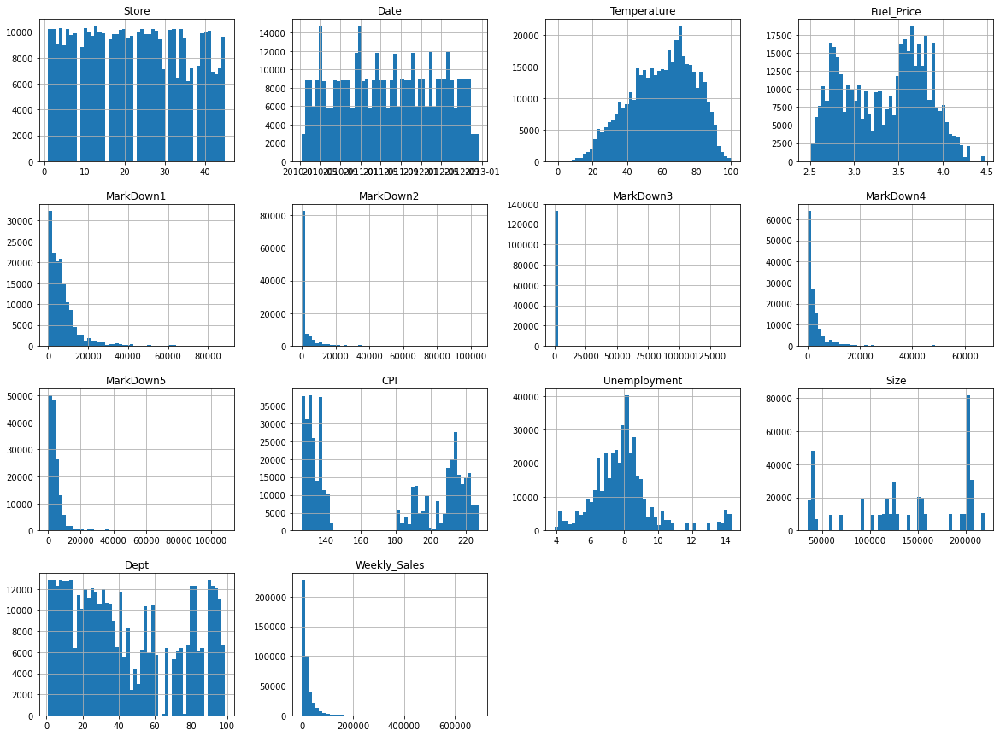

In [7]:
df.hist(bins=50, figsize=(20,15))
plt.show()

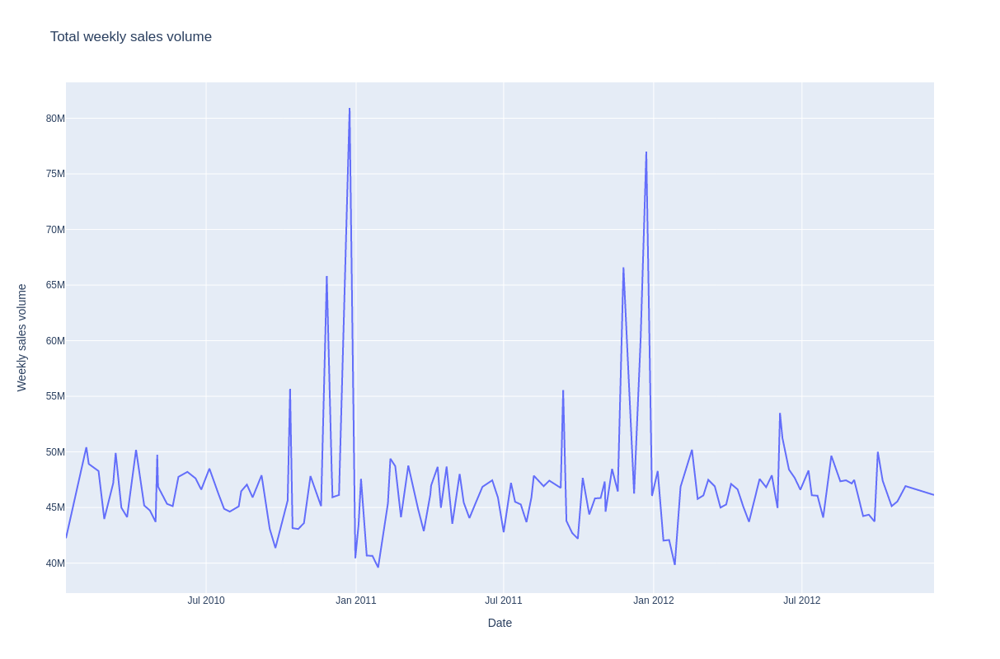

In [8]:
# Sum the weekly sales from every store to get the total weekly sales volume of the retail chain
df_total_weekly_sales = df.groupby(by=['Date'], as_index=False)['Weekly_Sales'].sum()
df_weekly_sales = df_total_weekly_sales.sort_values('Weekly_Sales', ascending=False)

fig = px.line(df_total_weekly_sales, x='Date', y='Weekly_Sales', title='Total weekly sales volume', width=1200, height=800, template='plotly', 
              labels={
                  'x':'Date', 'Weekly_Sales':'Weekly sales volume'
              }
            )
fig.show()

In [9]:
# Top 5 remunerative weeks
df_weekly_sales.head()

,Date,Weekly_Sales
46,2010-12-24,80931415.60
98,2011-12-23,76998241.31
95,2011-11-25,66593605.26
41,2010-11-26,65821003.24
45,2010-12-17,61820799.85


In [10]:
# Bottom 5 remunerative weeks
df_weekly_sales[::-1].head()

,Date,Weekly_Sales
52,2011-01-28,39599852.99
103,2012-01-27,39834974.67
47,2010-12-31,40432519.00
51,2011-01-21,40654648.03
50,2011-01-14,40673678.04


In [11]:
# Top performing store type in term of sales
df_top_stores = df.groupby(by=['Type'], as_index=False)['Weekly_Sales'].sum()
df_top_stores.sort_values('Weekly_Sales', ascending=False)

,Type,Weekly_Sales
0,A,4.331015e+09
1,B,2.000701e+09
2,C,4.055035e+08


### Plot correlation of variables

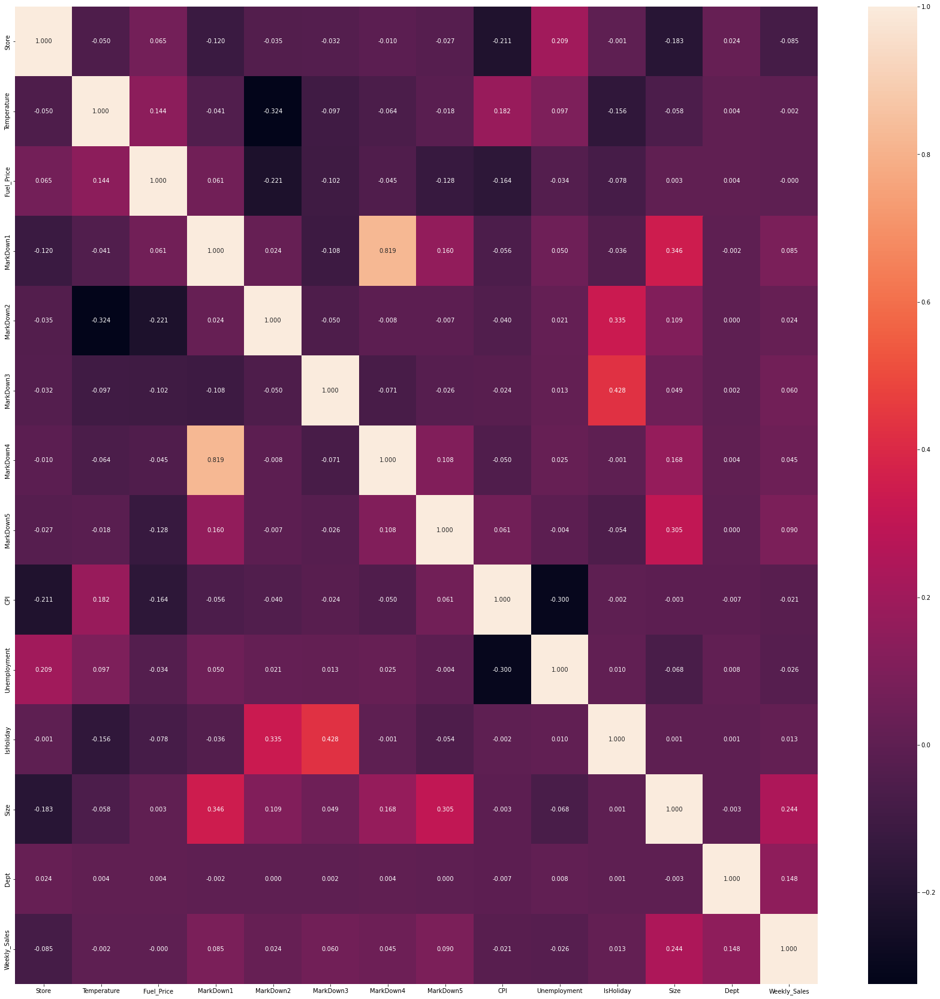

In [12]:
# Correlation matrix
corr = df.corr()
plt.figure(figsize=(30,30))
sns.heatmap(corr, 
            annot=True, fmt=".3f",
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values)
plt.show()

### Question 1 (1 pt)
Which feature has the highest correlation with "Weekly_Sales" except itself? 

$\color{blue}{\textit Your Answer:}$  *Size has the higest correlation with Weekly_Sales.*

In [13]:
corr['Weekly_Sales'].sort_values(ascending=False)

Weekly_Sales    1.000000
Size            0.243828
Dept            0.148032
MarkDown5       0.090362
MarkDown1       0.085251
MarkDown3       0.060385
MarkDown4       0.045414
MarkDown2       0.024130
IsHoliday       0.012774
Fuel_Price     -0.000120
Temperature    -0.002312
CPI            -0.020921
Unemployment   -0.025864
Store          -0.085195
Name: Weekly_Sales, dtype: float64

Choose the top 4 most correlated features with "Weekly_Sales". Fill in the following attributes to visualize their scatter plots.

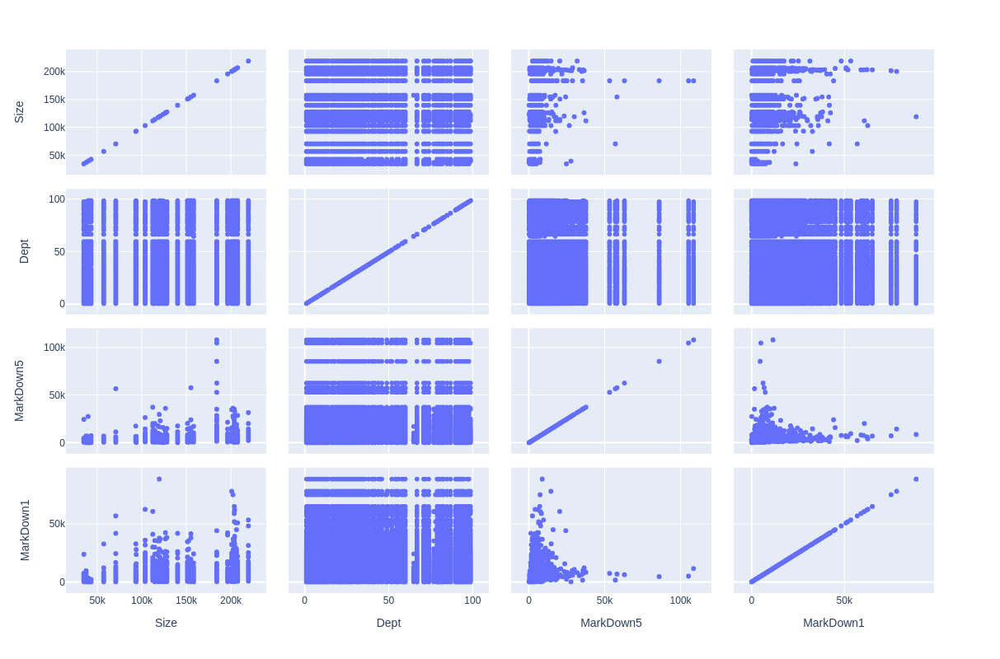

In [14]:
attributes = ['Size', 'Dept', 'MarkDown5', 'MarkDown1'] #TODO:Fill this in.
fig = px.scatter_matrix(df[attributes], width=1200, height=800)
fig.show()

### Data preparation for ML models

In [15]:
one_hot_encoding = pd.get_dummies(df['Type'])
df = df.join(one_hot_encoding)
df = df.drop(columns=['Type'])
df.head()

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Size,Dept,Weekly_Sales,A,B,C
0,1,2010-05-02,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,151315,1,24924.50,1,0,0
1,1,2010-05-02,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,151315,2,50605.27,1,0,0
2,1,2010-05-02,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,151315,3,13740.12,1,0,0
3,1,2010-05-02,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,151315,4,39954.04,1,0,0
4,1,2010-05-02,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,151315,5,32229.38,1,0,0


In order to interpolate NaN values, the dataframe must be indexed by Date

In [16]:
df = df.set_index(['Date', 'Store', 'Dept']).sort_index()
df

Temperature  Fuel_Price  MarkDown1  MarkDown2  \
Date       Store Dept                                                  
2010-01-10 1     1           71.89       2.603        NaN        NaN   
                 2           71.89       2.603        NaN        NaN   
                 3           71.89       2.603        NaN        NaN   
                 4           71.89       2.603        NaN        NaN   
                 5           71.89       2.603        NaN        NaN   
...                            ...         ...        ...        ...   
2012-12-10 45    93          54.47       4.000    1956.28        NaN   
                 94          54.47       4.000    1956.28        NaN   
                 95          54.47       4.000    1956.28        NaN   
                 97          54.47       4.000    1956.28        NaN   
                 98          54.47       4.000    1956.28        NaN   

                       MarkDown3  MarkDown4  MarkDown5         CPI  \
Date       Store Dept                                                
2010-01-10 1     1           NaN        NaN        NaN  211.671989   
                 2           NaN        NaN        NaN  211.671989   
                 3           NaN        NaN        NaN  211.671989   
                 4           NaN        NaN        NaN  211.671989   
                 5           NaN        NaN        NaN  211.671989   
...                          ...        ...        ...         ...   
2012-12-10 45    93         7.89     599.32    3990.54  192.327265   
                 94         7.89     599.32    3990.54  192.327265   
                 95         7.89     599.32    3990.54  192.327265   
                 97         7.89     599.32    3990.54  192.327265   
                 98         7.89     599.32    3990.54  192.327265   

                       Unemployment  IsHoliday    Size  Weekly_Sales  A  B  C  
Date       Store Dept                                                          
2010-01-10 1     1            7.838      False  151315      20094.19  1  0  0  
                 2            7.838      False  151315      45829.02  1  0  0  
                 3            7.838      False  151315       9775.17  1  0  0  
                 4            7.838      False  151315      34912.45  1  0  0  
                 5            7.838      False  151315      23381.38  1  0  0  
...                             ...        ...     ...           ... .. .. ..  
2012-12-10 45    93           8.667      False  118221       2644.24  0  1  0  
                 94           8.667      False  118221       4041.28  0  1  0  
                 95           8.667      False  118221      49334.77  0  1  0  
                 97           8.667      False  118221       6463.32  0  1  0  
                 98           8.667      False  118221       1061.02  0  1  0  

[421570 rows x 15 columns]

In [17]:
df['CPI'] = df['CPI'].interpolate(method='linear')
df['Unemployment'] = df['Unemployment'].interpolate(method='linear')
df

Temperature  Fuel_Price  MarkDown1  MarkDown2  \
Date       Store Dept                                                  
2010-01-10 1     1           71.89       2.603        NaN        NaN   
                 2           71.89       2.603        NaN        NaN   
                 3           71.89       2.603        NaN        NaN   
                 4           71.89       2.603        NaN        NaN   
                 5           71.89       2.603        NaN        NaN   
...                            ...         ...        ...        ...   
2012-12-10 45    93          54.47       4.000    1956.28        NaN   
                 94          54.47       4.000    1956.28        NaN   
                 95          54.47       4.000    1956.28        NaN   
                 97          54.47       4.000    1956.28        NaN   
                 98          54.47       4.000    1956.28        NaN   

                       MarkDown3  MarkDown4  MarkDown5         CPI  \
Date       Store Dept                                                
2010-01-10 1     1           NaN        NaN        NaN  211.671989   
                 2           NaN        NaN        NaN  211.671989   
                 3           NaN        NaN        NaN  211.671989   
                 4           NaN        NaN        NaN  211.671989   
                 5           NaN        NaN        NaN  211.671989   
...                          ...        ...        ...         ...   
2012-12-10 45    93         7.89     599.32    3990.54  192.327265   
                 94         7.89     599.32    3990.54  192.327265   
                 95         7.89     599.32    3990.54  192.327265   
                 97         7.89     599.32    3990.54  192.327265   
                 98         7.89     599.32    3990.54  192.327265   

                       Unemployment  IsHoliday    Size  Weekly_Sales  A  B  C  
Date       Store Dept                                                          
2010-01-10 1     1            7.838      False  151315      20094.19  1  0  0  
                 2            7.838      False  151315      45829.02  1  0  0  
                 3            7.838      False  151315       9775.17  1  0  0  
                 4            7.838      False  151315      34912.45  1  0  0  
                 5            7.838      False  151315      23381.38  1  0  0  
...                             ...        ...     ...           ... .. .. ..  
2012-12-10 45    93           8.667      False  118221       2644.24  0  1  0  
                 94           8.667      False  118221       4041.28  0  1  0  
                 95           8.667      False  118221      49334.77  0  1  0  
                 97           8.667      False  118221       6463.32  0  1  0  
                 98           8.667      False  118221       1061.02  0  1  0  

[421570 rows x 15 columns]

In [18]:
# Check for null values
df.isna().sum()

Temperature          0
Fuel_Price           0
MarkDown1       270889
MarkDown2       310322
MarkDown3       284479
MarkDown4       286603
MarkDown5       270138
CPI                  0
Unemployment         0
IsHoliday            0
Size                 0
Weekly_Sales         0
A                    0
B                    0
C                    0
dtype: int64

In [19]:
df['MarkDown1'] = IterativeImputer(random_state=0).fit_transform(df['MarkDown1'].values.reshape(-1, 1))
df['MarkDown2'] = IterativeImputer(random_state=0).fit_transform(df['MarkDown2'].values.reshape(-1, 1))
df['MarkDown3'] = IterativeImputer(random_state=0).fit_transform(df['MarkDown3'].values.reshape(-1, 1))
df['MarkDown4'] = IterativeImputer(random_state=0).fit_transform(df['MarkDown4'].values.reshape(-1, 1))
df['MarkDown5'] = IterativeImputer(random_state=0).fit_transform(df['MarkDown5'].values.reshape(-1, 1))

In [20]:
df

Temperature  Fuel_Price    MarkDown1    MarkDown2  \
Date       Store Dept                                                      
2010-01-10 1     1           71.89       2.603  7246.420196  3334.628621   
                 2           71.89       2.603  7246.420196  3334.628621   
                 3           71.89       2.603  7246.420196  3334.628621   
                 4           71.89       2.603  7246.420196  3334.628621   
                 5           71.89       2.603  7246.420196  3334.628621   
...                            ...         ...          ...          ...   
2012-12-10 45    93          54.47       4.000  1956.280000  3334.628621   
                 94          54.47       4.000  1956.280000  3334.628621   
                 95          54.47       4.000  1956.280000  3334.628621   
                 97          54.47       4.000  1956.280000  3334.628621   
                 98          54.47       4.000  1956.280000  3334.628621   

                         MarkDown3    MarkDown4    MarkDown5         CPI  \
Date       Store Dept                                                      
2010-01-10 1     1     1439.421384  3383.168256  4628.975079  211.671989   
                 2     1439.421384  3383.168256  4628.975079  211.671989   
                 3     1439.421384  3383.168256  4628.975079  211.671989   
                 4     1439.421384  3383.168256  4628.975079  211.671989   
                 5     1439.421384  3383.168256  4628.975079  211.671989   
...                            ...          ...          ...         ...   
2012-12-10 45    93       7.890000   599.320000  3990.540000  192.327265   
                 94       7.890000   599.320000  3990.540000  192.327265   
                 95       7.890000   599.320000  3990.540000  192.327265   
                 97       7.890000   599.320000  3990.540000  192.327265   
                 98       7.890000   599.320000  3990.540000  192.327265   

                       Unemployment  IsHoliday    Size  Weekly_Sales  A  B  C  
Date       Store Dept                                                          
2010-01-10 1     1            7.838      False  151315      20094.19  1  0  0  
                 2            7.838      False  151315      45829.02  1  0  0  
                 3            7.838      False  151315       9775.17  1  0  0  
                 4            7.838      False  151315      34912.45  1  0  0  
                 5            7.838      False  151315      23381.38  1  0  0  
...                             ...        ...     ...           ... .. .. ..  
2012-12-10 45    93           8.667      False  118221       2644.24  0  1  0  
                 94           8.667      False  118221       4041.28  0  1  0  
                 95           8.667      False  118221      49334.77  0  1  0  
                 97           8.667      False  118221       6463.32  0  1  0  
                 98           8.667      False  118221       1061.02  0  1  0  

[421570 rows x 15 columns]

In [21]:
df = df.reset_index()
df

,Date,Store,Dept,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Size,Weekly_Sales,A,B,C
0,2010-01-10,1,1,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,211.671989,7.838,False,151315,20094.19,1,0,0
1,2010-01-10,1,2,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,211.671989,7.838,False,151315,45829.02,1,0,0
2,2010-01-10,1,3,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,211.671989,7.838,False,151315,9775.17,1,0,0
3,2010-01-10,1,4,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,211.671989,7.838,False,151315,34912.45,1,0,0
4,2010-01-10,1,5,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,211.671989,7.838,False,151315,23381.38,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
421565,2012-12-10,45,93,54.47,4.000,1956.280000,3334.628621,7.890000,599.320000,3990.540000,192.327265,8.667,False,118221,2644.24,0,1,0
421566,2012-12-10,45,94,54.47,4.000,1956.280000,3334.628621,7.890000,599.320000,3990.540000,192.327265,8.667,False,118221,4041.28,0,1,0
421567,2012-12-10,45,95,54.47,4.000,1956.280000,3334.628621,7.890000,599.320000,3990.540000,192.327265,8.667,False,118221,49334.77,0,1,0
421568,2012-12-10,45,97,54.47,4.000,1956.280000,3334.628621,7.890000,599.320000,3990.540000,192.327265,8.667,False,118221,6463.32,0,1,0


In [22]:
df = df[df['Dept'].notna()]

In [23]:
# Date should be decomposed into Year and a cyclical feature for Day of Year
df['Year'] = df['Date'].dt.year
df['DayOfYear'] = df['Date'].dt.day
df['DayOfYearCos'] = np.cos(df['DayOfYear'])
df['DayOfYearSin'] = np.sin(df['DayOfYear'])

In [24]:
df.head()

,Date,Store,Dept,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,...,IsHoliday,Size,Weekly_Sales,A,B,C,Year,DayOfYear,DayOfYearCos,DayOfYearSin
0,2010-01-10,1,1,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,...,False,151315,20094.19,1,0,0,2010,10,-0.839072,-0.544021
1,2010-01-10,1,2,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,...,False,151315,45829.02,1,0,0,2010,10,-0.839072,-0.544021
2,2010-01-10,1,3,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,...,False,151315,9775.17,1,0,0,2010,10,-0.839072,-0.544021
3,2010-01-10,1,4,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,...,False,151315,34912.45,1,0,0,2010,10,-0.839072,-0.544021
4,2010-01-10,1,5,71.89,2.603,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,...,False,151315,23381.38,1,0,0,2010,10,-0.839072,-0.544021


In [25]:
# Normalizing values between 0 and 1
df['Store'] = MinMaxScaler().fit_transform(df['Store'].values.reshape((-1, 1)))
df['Temperature'] = MinMaxScaler().fit_transform(df['Temperature'].values.reshape((-1, 1)))
df['Fuel_Price'] = MinMaxScaler().fit_transform(df['Fuel_Price'].values.reshape((-1, 1)))
df['MarkDown1'] = MinMaxScaler().fit_transform(df['MarkDown1'].values.reshape((-1, 1)))
df['MarkDown2'] = MinMaxScaler().fit_transform(df['MarkDown2'].values.reshape((-1, 1)))
df['MarkDown3'] = MinMaxScaler().fit_transform(df['MarkDown3'].values.reshape((-1, 1)))
df['MarkDown4'] = MinMaxScaler().fit_transform(df['MarkDown4'].values.reshape((-1, 1)))
df['MarkDown5'] = MinMaxScaler().fit_transform(df['MarkDown5'].values.reshape((-1, 1)))
df['CPI'] = MinMaxScaler().fit_transform(df['CPI'].values.reshape((-1, 1)))
df['Unemployment'] = MinMaxScaler().fit_transform(df['Unemployment'].values.reshape((-1, 1)))
df['IsHoliday'] = df['IsHoliday'].astype(int)
df['Dept'] = MinMaxScaler().fit_transform(df['Dept'].values.reshape((-1, 1)))
df['Weekly_Sales'] = MinMaxScaler().fit_transform(df['Weekly_Sales'].values.reshape((-1, 1)))
df['Size'] = MinMaxScaler().fit_transform(df['Size'].values.reshape((-1, 1)))

In [26]:
df = df.set_index('Date')
df

,Store,Dept,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,...,IsHoliday,Size,Weekly_Sales,A,B,C,Year,DayOfYear,DayOfYearCos,DayOfYearSin
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-10,0.0,0.000000,0.723581,0.065631,0.081742,0.03436,0.010367,0.050137,0.041462,0.846190,...,0,0.630267,0.035931,1,0,0,2010,10,-0.839072,-0.544021
2010-01-10,0.0,0.010204,0.723581,0.065631,0.081742,0.03436,0.010367,0.050137,0.041462,0.846190,...,0,0.630267,0.072796,1,0,0,2010,10,-0.839072,-0.544021
2010-01-10,0.0,0.020408,0.723581,0.065631,0.081742,0.03436,0.010367,0.050137,0.041462,0.846190,...,0,0.630267,0.021149,1,0,0,2010,10,-0.839072,-0.544021
2010-01-10,0.0,0.030612,0.723581,0.065631,0.081742,0.03436,0.010367,0.050137,0.041462,0.846190,...,0,0.630267,0.057158,1,0,0,2010,10,-0.839072,-0.544021
2010-01-10,0.0,0.040816,0.723581,0.065631,0.081742,0.03436,0.010367,0.050137,0.041462,0.846190,...,0,0.630267,0.040640,1,0,0,2010,10,-0.839072,-0.544021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2012-12-10,1.0,0.938776,0.553131,0.765531,0.022065,0.03436,0.000261,0.008879,0.035571,0.654977,...,0,0.451136,0.010934,0,1,0,2012,10,-0.839072,-0.544021
2012-12-10,1.0,0.948980,0.553131,0.765531,0.022065,0.03436,0.000261,0.008879,0.035571,0.654977,...,0,0.451136,0.012936,0,1,0,2012,10,-0.839072,-0.544021
2012-12-10,1.0,0.959184,0.553131,0.765531,0.022065,0.03436,0.000261,0.008879,0.035571,0.654977,...,0,0.451136,0.077818,0,1,0,2012,10,-0.839072,-0.544021


In [27]:
X = df.drop(columns=['Weekly_Sales', 'Year', 'DayOfYear']).values
y = df['Weekly_Sales'].values

In [28]:
# Split training set into train and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=STATE)

In [29]:
dtr_regressor = DecisionTreeRegressor(max_depth=50, min_samples_leaf=200, random_state=STATE)
dtr_regressor = dtr_regressor.fit(X_train, y_train)
y_pred = dtr_regressor.predict(X_test)
r2_test = dtr_regressor.score(X_test, y_test)
print('R2 Score for test set:', r2_test)

R2 Score for test set: 0.8608393788432436


### Question 2 (4 pts) 
Use grid search with 5-fold cross-validation (with help of 'Grid Search CV' class) to find good hyperparameter values for a DecisionTreeRegressor. 
*(Hint: try various values for 'max_depth', 'min_samples_leaf', 'max_leaf_nodes' in the range 0-200)*

Measure your model's performance on the test set. 

In [67]:
dtr_model = DecisionTreeRegressor(random_state=STATE)
dtr_model

parameters = {
    'max_depth':[11,16,21,26], #np.arange(1,200,10),
    'min_samples_leaf':[1,6,11,16] #np.arange(1,200,10),
}

dtr_gscv = GridSearchCV(estimator=dtr_model, param_grid=parameters, cv=5)
dtr_gscv.fit(X_train, y_train)
dtr_gscv.best_params_

{'max_depth': 26, 'min_samples_leaf': 6}

In [68]:
dtr_regressor = DecisionTreeRegressor(max_depth=26, min_samples_leaf=6, random_state=STATE)
dtr_regressor = dtr_regressor.fit(X_train, y_train)
y_pred = dtr_regressor.predict(X_test)
r2_test = dtr_regressor.score(X_test, y_test)
print('R2 Score for test set:', r2_test)

R2 Score for test set: 0.9304423156457192


### Question 3 (8 pts)
Try different boosting regressors from 'sklearn.ensemble' (RandomForest, AdaBoost) with Grid Search CV and report their testing and prediction accuracies

In [32]:
# fit random forest model
rfr_model = RandomForestRegressor(random_state=STATE)
rfr_model

parameters = {
    'n_estimators':np.arange(1,200,50),
    # 'max_features':"auto"
}

rfr_gscv = GridSearchCV(estimator=rfr_model, param_grid=parameters, cv=5)
rfr_gscv.fit(X_train, y_train)
rfr_gscv.best_params_


{'n_estimators': 151}

In [33]:
rfr_model = RandomForestRegressor(n_estimators=151,random_state=STATE)
rfr_model.fit(X_train, y_train)
y_pred = rfr_model.predict(X_test)
# accuracy_score(y_test, y_pred)
r2_test = rfr_model.score(X_test, y_test)
print('R2 Score for test set:', r2_test)

R2 Score for test set: 0.9526493068159765


In [34]:
# fit adaboost model
abr_model = AdaBoostRegressor(random_state=STATE)
abr_model

parameters = {
    'n_estimators':np.arange(1,200,50)
}

abr_gscv = GridSearchCV(estimator=abr_model, param_grid=parameters, cv=5)
abr_gscv.fit(X_train, y_train)
abr_gscv.best_params_


{'n_estimators': 1}

In [35]:
abr_model = AdaBoostRegressor(n_estimators=1)
abr_model.fit(X_train, y_train)
y_pred = abr_model.predict(X_test)
#accuracy_score(y_test, y_pred)
r2_test = abr_model.score(X_test, y_test)
print('R2 Score for test set:', r2_test)

R2 Score for test set: 0.37079218356934684


In [36]:
# fit gradient boosting model
gbr_model = GradientBoostingRegressor(random_state=STATE)
gbr_model

parameters = {
    'n_estimators':np.arange(1,200,50)
}

gbr_gscv = GridSearchCV(estimator=gbr_model, param_grid=parameters, cv=5)
gbr_gscv.fit(X_train, y_train)
gbr_gscv.best_params_


{'n_estimators': 151}

In [37]:
gbr_model = GradientBoostingRegressor(n_estimators=150)
gbr_model.fit(X_train, y_train)
y_pred = gbr_model.predict(X_test)
#accuracy_score(y_test, y_pred)
r2_test = gbr_model.score(X_test, y_test)
print('R2 Score for test set:', r2_test)

R2 Score for test set: 0.7761951472539851


### Question 4 (7 pts)
Ensemble (stack) the regressors from the above and report the R2 score on test set.

In [38]:
bl_stack = [
    ('random_forest', RandomForestRegressor(n_estimators=150, random_state=STATE)),
    ('ada', AdaBoostRegressor(n_estimators=1,random_state=STATE)),
    ('gradient_boosting', GradientBoostingRegressor(n_estimators=150,random_state=STATE))
]

ml = LinearRegression()

s_model = StackingRegressor(estimators=bl_stack, final_estimator=ml, cv=5)
s_model.fit(X_train, y_train)
y_pred = s_model.predict(X_test)
#accuracy_score(y_test, y_pred)
r2_test = s_model.score(X_test, y_test)
print('R2 Score for test set:', r2_test)

R2 Score for test set: 0.9526808978240568
